# Step 5: 2D Linear Convection

Up to now, all of our work had been done in one dimension. Today we level up and move to 2D equations. The changes are relatively simple, we will simply extend the previous 4 steps from 1D to 2D. To extend the finite difference formulas we have worked on to 2D or 3D we just apply a simple definition: a partial derivative with respect to $x$ is the variation in the $x$ fdirection *at constant * $y$.

We start by redefining the grid we have been working on. It is defined by the points on the coordinates contained within:

$$
x_i = x_0 +i \Delta x $$


$$
y_i = y_0 +i \Delta y $$

Now, we redefine our u equation as $ u_{i,j} = u(x_i, y_i) $ and apply the finite-difference formulas on either variable $x$ or $y$ *acting separately* on the $i$ and $j$ indices. All derivatives are based on the 2D Taylor expansion of a mesh point value around $u_{i,j}$.

Hence, for the first-order partial derivative in the $x$ direction, a finite difference formula looks like this:

$$
\frac{u}{x}\biggr\rvert_{i,j} = \frac{u_{i+1,j} - u_{i,j}}{\Delta x} + \mathcal{O}(\Delta x)
$$

And similarly in the  $y$ direction. Thys we can write backward, forward or central diffrence formulas for the next steps 5-12. 

## Governing Equations

The PDE governing 2D Linear Convection is written as:

$$ \frac{\partial u}{\partial t} + c \frac{\partial u}{\partial x} + c\frac{\partial u}{\partial y} = 0 $$

If this looks suspiciously familiar to you I know why! This is exactly the same form as the 1D linear convection except that now we have two spatial dimensions to account for as we move forward in time. 

## Discretization

Similarly as before we we shall discretize the timestep as a forward difference and both spatial steps will be discretized as backward differences. 

However, unlike in our 1D implementations, Using the subscript $i$ to denote movement in space is not sufficient (e.g. $ u^n_i - u^n_{i - 1} $). Now we must account for the second dimension using a second subscript, $j$ that will account for all the spatial information in the regime.

Here, we'll again use $i$ as the index for our $x$ values and $j$ for our $y$ values.

With that cleared out the way we can go ahead and discretize as we did in step 1 with the following results:

$$
 \frac{ u^{n+1}_{i,j} - u^n_{i,j}} {\Delta t} + c \frac{u^{n}_{i,j} - u^n_{i-1,j}}{\Delta x} + c \frac{u^{n}_{i,j} - u^n_{i,j-1}}{\Delta y} = 0
$$

As always, we solve for our only unknown $u^{n+1}_{i,j}$ and iterate through the equation that follows:

$$ u^{n+1}_{i,j} = u^n_{i,j} - c \frac{\Delta t}{\Delta x} (u^n_{i,j} - u^n_{i-1,j})  - c \frac{\Delta t}{\Delta y} (u^n_{i,j} - u^n_{i,j-1}) 
$$

## Initial and Boundary Conditions

We will solve the equation with the following initial conditions:

$$ u(x,y) = \begin{cases}
\begin{matrix}
2 \ \text{for} & 0.5 \leq x, y \leq 1 \cr
1 \ \text{for} & \text{everywhere else}
\end{matrix}\end{cases}
$$

And boundary conditions:

$$ u = 1\ \text{for}  \begin{cases}
\begin{matrix}
 x = 0,2 \cr
 y = 0,2 
\end{matrix}
\end{cases}
$$

With this we are now ready to setup the variables, include our libraries and beging our simulation:

## Libraries and Variable declarations

### Lib import

In [1]:
# Adding inline command to make plots appear under comments
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

### Variable Declarations

In [2]:
grid_length_x = 2
grid_length_y = 2
grid_points_x = 81
grid_points_y = 81
nt = 100
c = 1
dx = grid_length_x / (grid_points_x - 1) 
dy = grid_length_y / (grid_points_y - 1) 
sigma = .2 
dt = sigma*dx

x = np.linspace(0, grid_length_x, grid_points_x)
y = np.linspace(0, grid_length_y, grid_points_y)
u = np.ones((grid_points_x, grid_points_y))
un = np.ones((grid_points_x, grid_points_y))

#Initiallizing the array containing the shape of our initial conditions

u[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2 

### Plotting initial conditions

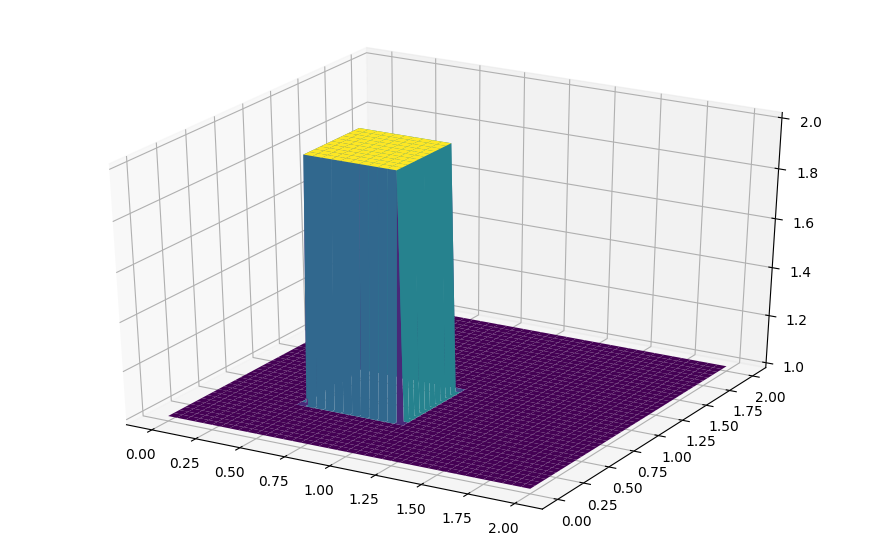

In [3]:
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)
surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis)

### Notes about plotting in 3D

To plot a projected 3D result we use the Axes3D library

    from mpl_toolkits.mplot3d import Axes3D 
    
The actual plotting commands are more elaborate than what we have seen so far.

```python
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis)
```

The first line is initializing a figure window. The **figsize** and **dpi** parameters are commands that are optional and specify the size and resolution of the figure being produced.

    fig = plt.figure(figsize=(11,7), dpi= 100)

The next line assigns tyhe plot window the axes label 'ax' and also specifies that iti will be a 3d projection plot.

    ax = fig.gca(projection='3d')

The last line is equivalent to the regular plot command by takes a grid of X and Y values for the data points.

    surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis)
    
### Note on grid points and matplotlib

The `X` and `Y` values that you pass to `plot_surface` are not the 1-D vectors of `x` and `y`. In order to do 3D plots you need to generate a grid of `x,y` values taht correspond to each coordinate in the plotting frame. This coordinate grid is generated using the `meshgrid` function.

    X, Y = np.meshgrid(x,y)
    
### Notes about iterating in two dimensions

To evaluate the wave in two dimensions requries the use of several nested for-loops to cover all of the `i` and `j`. Since pythong is not a compiled language, it is much slower with code that requires multiple for loops. We shall attempt it first in this fashion and then in a more vectorized way.

## Solving in 2D

In [4]:
for n in range(nt + 1): #Runs however many timesteps you set earlier
    un = u.copy()   #copy the u array to not overwrite values
    row, col = u.shape
    for j in range(1,row):
        for i in range(1,col):
            u[j, i] = (un[j, i] - (c*dt / dx * (un[j , i] - un[j, i-1])) - (c*dt / dx * (un[j , i] - un[j - 1, i])))
            
            u[0,:] = 1
            u[-1,:] = 1
            u[:,0] = 1
            u[:,-1] = 1

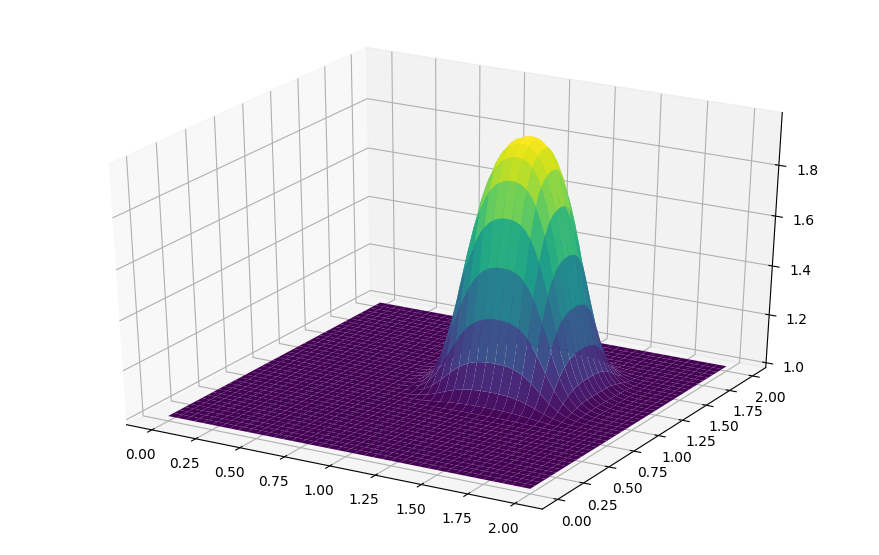

In [5]:
fig = plt.figure(figsize=(11,7), dpi=100)
ax  = fig.gca(projection='3d')
surf2 = ax.plot_surface(X,Y, u[:],cmap=cm.viridis)

### Results

As we can see, the same behavior from the 1D sim is also occurring here. It would also be very cool to see this in an animation, so as always, we are returning to the arduous task of building an animation of this sim.

But wait!! Before we can move towards doing that, let's rewrite the code above in a more vectorized form to speed it up and use it in our animation section.

In [6]:
u = np.ones((grid_points_x, grid_points_y))
u[int(.5 / dy):int(1 / dy + 1), int(.5 / dx):int(1 / dx + 1)] = 2

for n in range(nt + 1): ##loop across number of time steps
    un = u.copy()
    u[1:, 1:] = (un[1:, 1:] - (c * dt / dx * (un[1:, 1:] - un[1:, :-1])) -
                              (c * dt / dy * (un[1:, 1:] - un[:-1, 1:])))
    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1

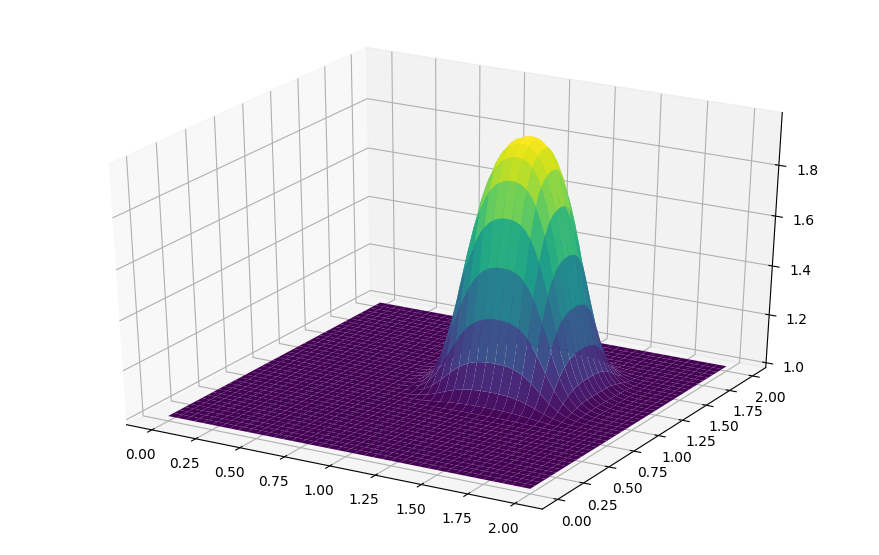

In [7]:
fig = plt.figure(figsize=(11,7), dpi=100)
ax  = fig.gca(projection='3d')
surf2 = ax.plot_surface(X,Y, u[:],cmap=cm.viridis)

Looks exactly the same but is waaayyy faster. Onwards towards animating.

## Animating the simulation

/home/angel/.local/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  del sys.path[0]


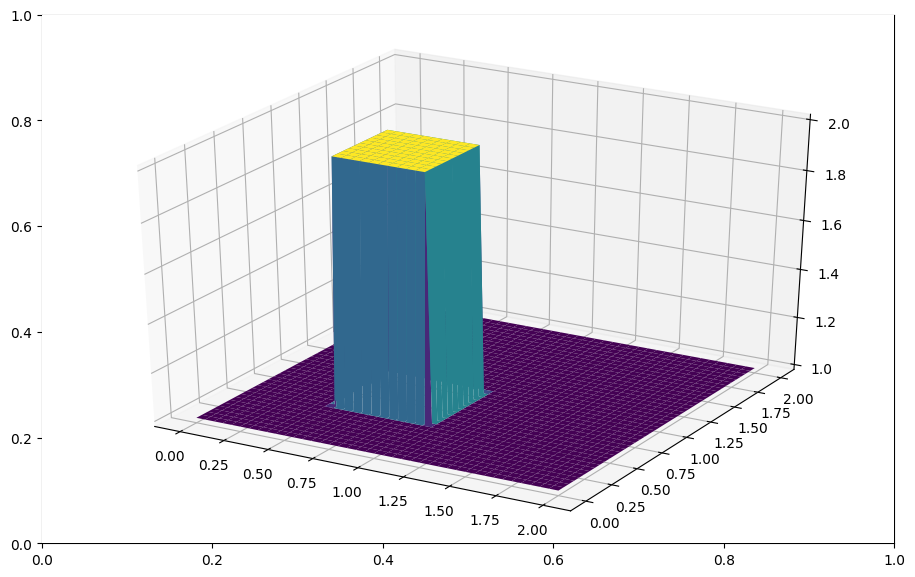

In [8]:
#Imports for animation and display within a jupyter notebook
from matplotlib import animation, rc 
from IPython.display import HTML

#Resetting the U wave back to initial conditions
u = np.ones((grid_points_x, grid_points_y))
u[int(.5 / dy):int(1 / dy + 1), int(.5 / dx):int(1 / dx + 1)] = 2

#Generating the figure that will contain the animation
fig, ax = plt.subplots()
fig.set_dpi(100)
fig.set_size_inches(11,7)
ax = fig.gca(projection='3d')

surf = ax.plot_surface(X, Y, u[:] , cmap=cm.viridis)



In [9]:
#Initialization function for funcanimation
def init():
    ax.clear()
    surf = ax.plot_surface(X, Y, u[:] , cmap=cm.viridis)
    return surf

In [10]:
#Main animation function, each frame represents a time step in our calculation
def animate(j):
    un = u.copy()   #copy the u array to not overwrite values
    u[1:, 1:] = (un[1:, 1:] - (c * dt / dx * (un[1:, 1:] - un[1:, :-1])) -
                              (c * dt / dy * (un[1:, 1:] - un[:-1, 1:])))
    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1
    ax.clear()
    surf = ax.plot_surface(X, Y, u[:] , cmap=cm.viridis)
    return surf

In [11]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nt, interval=20)
HTML(anim.to_jshtml())

Animation size has reached 21014133 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Conclusion

Onwards and upwards! We have completed the 